- toc: true
- badges: true
- comments: true
- author: Wale
- categories: [jupyter, research implementation]
- image: /images/2020-03-09-progressively-grown-gans/media/Pro-GAN.png

# Background Matting Colab Notebook

Hello there! This notebook walks you through how to use the inference code supplied by the Hardworking researchers over at Washington University. Feel free to create a copy of this notebook and hack away at creating your own mattes. 





First of all, let's clone their hard work.




In [1]:
!git clone https://github.com/senguptaumd/Background-Matting.git

Cloning into 'Background-Matting'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 124 (delta 2), reused 1 (delta 0), pack-reused 114
Receiving objects: 100% (124/124), 59.16 MiB | 30.14 MiB/s, done.
Resolving deltas: 100% (58/58), done.


Now, we shimmy into the correct working directory like so:

In [2]:
%cd /content/Background-Matting/

/content/Background-Matting


Create directories for storing the different models

In [0]:
!mkdir /content/Background-Matting/Models/
!mkdir /content/Background-Matting/Models/real-fixed-cam
!mkdir /content/Background-Matting/Models/real-hand-held

Now in order to make this snappy, we need to get the pretrained models. That's much easier and faster than trainng it from scratch (also, the code for training isn't available yet. lol). 

The researchers have graciously made their models available in google drive [here](https://drive.google.com/drive/folders/1WLDBC_Q-cA72QC8bB-Rdj53UB2vSPnXv?usp=sharing). 

I figured it would be quite cumbersome if you had to download the weights locally, then upload them to your google drive only for you to have to mount the drive, wouldn't it? 
Exactly.
So, we won't be doing that. Instead, we will use gdown to get the files using thir shareable links.

So here is what you're gonna do.


1.   Go to the google drive link in the previous cell.
2.   Open Models/real_fixed_cam to reveal netG_epoch_12.pth
3.   Right click on the file and copy the shareable link. 

It should look like this : https://drive.google.com/open?id=1yiNsSkPYoBZ55fSQ1iwb1io9QL_PcR2i

4. change the "open" in the link to "uc". Save the link somewhere you can easily reach it.



Now install "gdown" so we can download the pretrained weights

In [4]:
!pip install gdown

Pass in our edited link to gdown so it can work its magic, like so: 

In [5]:
!gdown https://drive.google.com/uc?id=1yiNsSkPYoBZ55fSQ1iwb1io9QL_PcR2i

Downloading...
From: https://drive.google.com/uc?id=1yiNsSkPYoBZ55fSQ1iwb1io9QL_PcR2i
To: /content/Background-Matting/netG_epoch_12.pth
71.8MB [00:02, 33.9MB/s]


That downloaded the model for real-fixed-cams to the working directory. But it isn't where we would like it to be just yet. To do that, we use shutil. shutil is inbuilt with python and can be used for manipulating files and folders like so:

In [6]:
import shutil
shutil.move("/content/Background-Matting/netG_epoch_12.pth", "Models/real-fixed-cam")

'Models/real-fixed-cam/netG_epoch_12.pth'

There. Now we just have to do the same thing for the model for hand held cameras. The weights for the hand held camera version can be found in Models/real_hand_held. You can download them like so:

In [7]:
!gdown https://drive.google.com/uc?id=13HckO9fPAKYocdB_CAC5n8uyM3xQ2MpG

Downloading...
From: https://drive.google.com/uc?id=13HckO9fPAKYocdB_CAC5n8uyM3xQ2MpG
To: /content/Background-Matting/netG_epoch_12.pth
71.8MB [00:00, 87.9MB/s]


... move with shutil...

In [8]:
shutil.move("/content/Background-Matting/netG_epoch_12.pth", "Models/real-hand-held")

'Models/real-hand-held/netG_epoch_12.pth'

If you checkout the "[getting started](https://github.com/senguptaumd/Background-Matting)" section oftheir repo, they say to use tensorflow 1.14. But you see, I'm a progressive, and I like making things break so I can fix em. So, I'm gonna stick with 2.2. Here's how you check your tensorflow version:

In [9]:
%tensorflow_version 2.x

import tensorflow as tf
print(tf.__version__)

2.2.0-rc2


Install the requirements in the requirements.txt file.
Can you smell the errors yet? No? 

In [10]:
!pip install -r /content/Background-Matting/requirements.txt

     |████████████████████████████████| 20.4MB 1.4MB/s 
     |████████████████████████████████| 25.4MB 85kB/s 
     |████████████████████████████████| 25.3MB 93kB/s 
     |████████████████████████████████| 24.8MB 131kB/s 
ERROR: tensorflow 2.2.0rc2 has requirement scipy==1.4.1; python_version >= "3", but you'll have scipy 1.2.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: numpy 1.18.2
    Uninstalling numpy-1.18.2:
      Successfully uninstalled numpy-1.18.2
  Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
  Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
  Found existing installation: scik

Go ahead and restart the runtime, and then change back to the working directory. 
Trust me. It'll work.

In [1]:
%cd /content/Background-Matting/

/content/Background-Matting


You can optionally download the Adobe trained weights, but I have commented them out because I didn't use them. Uncomment them if you want to be adventurous when the training scripts are released.

In [2]:
#!gdown https://drive.google.com/uc?id=11POaBmHUkSwJbLZVa8rCcnfwTDzZh6Kj

Downloading...
From: https://drive.google.com/uc?id=11POaBmHUkSwJbLZVa8rCcnfwTDzZh6Kj
To: /content/Background-Matting/netG_epoch_44.pth
71.8MB [00:03, 20.1MB/s]


In [3]:
#!gdown https://drive.google.com/uc?id=1c-Sd8fGk0uFUI1qxCzuLe24OQeDAdwp6

Downloading...
From: https://drive.google.com/uc?id=1c-Sd8fGk0uFUI1qxCzuLe24OQeDAdwp6
To: /content/Background-Matting/net_epoch_64.pth
71.8MB [00:02, 31.6MB/s]


.... shutil them...

In [0]:
#import shutil # Need to import it again because it got cleared when we restarted runtime
#models = ["netG_epoch_44.pth", "net_epoch_64.pth"]
#for m in models:
#  shutil.move(m, "Models/")

Now, lets fetch other peopl's work. We need to create segmentation masks along the way. Rather than build and train one from scratch, we follow the best practice of not reinventing the wheel:

LEVERAGE ON OTHER PEOPLE'S WORK RESPECTFULY!!!!

In [2]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 6, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 33875 (delta 0), reused 6 (delta 0), pack-reused 33869
Receiving objects: 100% (33875/33875), 512.18 MiB | 30.12 MiB/s, done.
Resolving deltas: 100% (21809/21809), done.
Checking out files: 100% (2490/2490), done.


In [3]:
cd models/research/  # Well, this line turned out to be a complete waste of time.

[Errno 2] No such file or directory: 'models/research/ # Well, this line turned out to be a complete waste of time.'
/content/Background-Matting


In [4]:
%cd /content/Background-Matting/  # correct the directory

[Errno 2] No such file or directory: '/content/Background-Matting/ # correct the directory'
/content/Background-Matting


# Tricky parts

Remember those errors I said were gonna come? Well, here they are. If we don't modify their scripts, we are gonna run into a hell of a lot of headache. In order to explain the changes to you, I have turned on the numbering of lines of code. I'll reference the changes I made based on the line numbers.

I can al most here some smart alec going: "But how do we edit .py files in google colab?!"
Yes, yes. 2 days ago, I was just like you. Completely clueless. But we thank Google for, well, Google!  

In order to edit the .py files without having to download it to your local machine, use a simple trick.

> Call up the .py file, test_segmentation_deeplab.py in our case, like this:

```
%pycat test_segmentation_deeplab.py
```

> Copy the cintent of whatever pops up. Paste all of it into a cell in colab.


> Make edits as appropriate
In this case, I changed how tensorflow was imported, so the version 2.2 we are using is compatible with their 1.14 code. Then, I disabled the version 2 behavior, like so:



```
12 # import tensorflow as tf
13 import tensorflow.compat.v1 as tf
14 tf.disable_v2_behavior()
```


> Also had errors with line 34.
Changed it from: 

```
34 graph_def = tf.GraphDef.FromString(file_handle.read())
```
to:

```
34 graph_def = tf.compat.v1.GraphDef.FromString(file_handle.read())
```


> Aaaaaand line 146 chenged from:

```
146 tf.gfile.makedirs(model_dir)
```
to:
```
146 tf.io.gfile.makedirs(model_dir)
```

> Remove the file with defective code.


```
!rm test_segmentation_deeplab.py
```

> Add : 

```
%%writefile test_segmentation_deeplab.py
```
to the top of the cell containing the code you edited.










Alright, let's go ahead and implement all that gibberish. sheesh!

In [0]:
#If you run into error for the segmentation, do the following:
#%pycat test_segmentation_deeplab.py

In [0]:
!rm test_segmentation_deeplab.py

In [6]:
%%writefile test_segmentation_deeplab.py
import os
from io import BytesIO
import tarfile
import tempfile
from six.moves import urllib

import numpy as np
from PIL import Image
import cv2, pdb, glob, argparse

#import tensorflow as tf
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()


class DeepLabModel(object):
        """Class to load deeplab model and run inference."""

        INPUT_TENSOR_NAME = 'ImageTensor:0'
        OUTPUT_TENSOR_NAME = 'SemanticPredictions:0'
        INPUT_SIZE = 513
        FROZEN_GRAPH_NAME = 'frozen_inference_graph'

        def __init__(self, tarball_path):
                #"""Creates and loads pretrained deeplab model."""
                self.graph = tf.Graph()
                graph_def = None
                # Extract frozen graph from tar archive.
                tar_file = tarfile.open(tarball_path)
                for tar_info in tar_file.getmembers():
                        if self.FROZEN_GRAPH_NAME in os.path.basename(tar_info.name):
                                file_handle = tar_file.extractfile(tar_info)
                                graph_def = tf.compat.v1.GraphDef.FromString(file_handle.read())
                                break

                tar_file.close()

                if graph_def is None:
                        raise RuntimeError('Cannot find inference graph in tar archive.')

                with self.graph.as_default():
                        tf.import_graph_def(graph_def, name='')

                self.sess = tf.Session(graph=self.graph)

        def run(self, image):
                """Runs inference on a single image.

                Args:
                  image: A PIL.Image object, raw input image.

                Returns:
                  resized_image: RGB image resized from original input image.
                  seg_map: Segmentation map of `resized_image`.
                """
                width, height = image.size
                resize_ratio = 1.0 * self.INPUT_SIZE / max(width, height)
                target_size = (int(resize_ratio * width), int(resize_ratio * height))
                resized_image = image.convert('RGB').resize(target_size, Image.ANTIALIAS)
                batch_seg_map = self.sess.run(
                        self.OUTPUT_TENSOR_NAME,
                        feed_dict={self.INPUT_TENSOR_NAME: [np.asarray(resized_image)]})
                seg_map = batch_seg_map[0]
                return resized_image, seg_map

def create_pascal_label_colormap():
        """Creates a label colormap used in PASCAL VOC segmentation benchmark.

        Returns:
        A Colormap for visualizing segmentation results.
        """
        colormap = np.zeros((256, 3), dtype=int)
        ind = np.arange(256, dtype=int)

        for shift in reversed(range(8)):
                for channel in range(3):
                  colormap[:, channel] |= ((ind >> channel) & 1) << shift
                ind >>= 3

        return colormap

def label_to_color_image(label):
        """Adds color defined by the dataset colormap to the label.

        Args:
        label: A 2D array with integer type, storing the segmentation label.

        Returns:
        result: A 2D array with floating type. The element of the array
          is the color indexed by the corresponding element in the input label
          to the PASCAL color map.

        Raises:
        ValueError: If label is not of rank 2 or its value is larger than color
          map maximum entry.
        """
        if label.ndim != 2:
                raise ValueError('Expect 2-D input label')

        colormap = create_pascal_label_colormap()

        if np.max(label) >= len(colormap):
                raise ValueError('label value too large.')

        return colormap[label]



parser = argparse.ArgumentParser(description='Deeplab Segmentation')
parser.add_argument('-i', '--input_dir', type=str, required=True,help='Directory to save the output results. (required)')
args=parser.parse_args()

dir_name=args.input_dir;


## setup ####################

LABEL_NAMES = np.asarray([
        'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
        'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
        'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
])

FULL_LABEL_MAP = np.arange(len(LABEL_NAMES)).reshape(len(LABEL_NAMES), 1)
FULL_COLOR_MAP = label_to_color_image(FULL_LABEL_MAP)


MODEL_NAME = 'xception_coco_voctrainval'  # @param ['mobilenetv2_coco_voctrainaug', 'mobilenetv2_coco_voctrainval', 'xception_coco_voctrainaug', 'xception_coco_voctrainval']

_DOWNLOAD_URL_PREFIX = 'http://download.tensorflow.org/models/'
_MODEL_URLS = {
        'mobilenetv2_coco_voctrainaug':
                'deeplabv3_mnv2_pascal_train_aug_2018_01_29.tar.gz',
        'mobilenetv2_coco_voctrainval':
                'deeplabv3_mnv2_pascal_trainval_2018_01_29.tar.gz',
        'xception_coco_voctrainaug':
                'deeplabv3_pascal_train_aug_2018_01_04.tar.gz',
        'xception_coco_voctrainval':
                'deeplabv3_pascal_trainval_2018_01_04.tar.gz',
}
_TARBALL_NAME = _MODEL_URLS[MODEL_NAME]

model_dir = 'deeplab_model'
if not os.path.exists(model_dir):
  tf.io.gfile.makedirs(model_dir)

download_path = os.path.join(model_dir, _TARBALL_NAME)
print('downloading model to %s, this might take a while...' % download_path)
if not os.path.exists(download_path):
  urllib.request.urlretrieve(_DOWNLOAD_URL_PREFIX + _MODEL_URLS[MODEL_NAME], 
                             download_path)
  print('download completed! loading DeepLab model...')

MODEL = DeepLabModel(download_path)
print('model loaded successfully!')

#######################################################################################


list_im=glob.glob(dir_name + '/*_img.png'); list_im.sort()


for i in range(0,len(list_im)):

        image = Image.open(list_im[i])

        res_im,seg=MODEL.run(image)

        seg=cv2.resize(seg.astype(np.uint8),image.size)

        mask_sel=(seg==15).astype(np.float32)


        name=list_im[i].replace('img','masksDL')
        cv2.imwrite(name,(255*mask_sel).astype(np.uint8))

str_msg='\nDone: ' + dir_name
print(str_msg)

Writing test_segmentation_deeplab.py


If you somehow run into errors you can't fix, just copy the cell into yours. I don't mind. 

run the edited segmentation script now.

In [7]:
!python test_segmentation_deeplab.py -i sample_data/input

2020-04-14 17:40:00.132997: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
Instructions for updating:
non-resource variables are not supported in the long term
downloading model to deeplab_model/deeplabv3_pascal_trainval_2018_01_04.tar.gz, this might take a while...
download completed! loading DeepLab model...
2020-04-14 17:40:18.571213: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-04-14 17:40:18.616719: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-04-14 17:40:18.617702: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB dev

Preprocess your images, so the backgrounds are aligned. This is especially important if you did not use a fixed camera on a tripod.

In [8]:
!python test_pre_process.py -i sample_data/input


Done: sample_data/input


We need to perform similar steps to what we did for the segmentation script to the background matting script.

In [0]:
#%pycat test_background-matting_image.py

In [0]:
!rm test_background-matting_image.py

You need to edit the following:
```
#os.environ["CUDA_VISIBLE_DEVICES"]="4"
```
to:

```
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"
```
This just selects the CUDA devices to be used for the matting process. It's a real headache if you don't change it. Trust me.

Dont forget to remove the defective file and write your changes by adding 

%%writefile test_background-matting_image.py

to the top of the edited file.



In [10]:
%%writefile test_background-matting_image.py

from __future__ import print_function


import os, glob, time, argparse, pdb, cv2
#import matplotlib.pyplot as plt
import numpy as np
from skimage.measure import label


import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.backends.cudnn as cudnn

from functions import *
from networks import ResnetConditionHR

torch.set_num_threads(1)
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"
print('CUDA Device: ' + os.environ["CUDA_VISIBLE_DEVICES"])


"""Parses arguments."""
parser = argparse.ArgumentParser(description='Background Matting.')
parser.add_argument('-m', '--trained_model', type=str, default='real-fixed-cam',choices=['real-fixed-cam', 'real-hand-held', 'syn-comp-adobe'],help='Trained background matting model')
parser.add_argument('-o', '--output_dir', type=str, required=True,help='Directory to save the output results. (required)')
parser.add_argument('-i', '--input_dir', type=str, required=True,help='Directory to load input images. (required)')
parser.add_argument('-tb', '--target_back', type=str,help='Directory to load the target background.')
parser.add_argument('-b', '--back', type=str,default=None,help='Captured background image. (only use for inference on videos with fixed camera')


args=parser.parse_args()

#input model
model_main_dir='Models/' + args.trained_model + '/';
#input data path
data_path=args.input_dir

if os.path.isdir(args.target_back):
        args.video=True
        print('Using video mode')
else:
        args.video=False
        print('Using image mode')
        #target background path
        back_img10=cv2.imread(args.target_back); back_img10=cv2.cvtColor(back_img10,cv2.COLOR_BGR2RGB);
        #Green-screen background
        back_img20=np.zeros(back_img10.shape); back_img20[...,0]=120; back_img20[...,1]=255; back_img20[...,2]=155;



#initialize network
fo=glob.glob(model_main_dir + 'netG_epoch_*.pth')
model_name1=fo[0]
netM=ResnetConditionHR(input_nc=(3,3,1,4),output_nc=4,n_blocks1=7,n_blocks2=3)
netM=nn.DataParallel(netM)
netM.load_state_dict(torch.load(model_name1))
netM.cuda(); netM.eval()
cudnn.benchmark=True
reso=(512,512) #input reoslution to the network

#load captured background for video mode, fixed camera
if args.back is not None:
        bg_im0=cv2.imread(args.back); bg_im0=cv2.cvtColor(bg_im0,cv2.COLOR_BGR2RGB);


#Create a list of test images
test_imgs = [f for f in os.listdir(data_path) if
                           os.path.isfile(os.path.join(data_path, f)) and f.endswith('_img.png')]
test_imgs.sort()

#output directory
result_path=args.output_dir

if not os.path.exists(result_path):
        os.makedirs(result_path)

for i in range(0,len(test_imgs)):
        filename = test_imgs[i] 
        #original image
        bgr_img = cv2.imread(os.path.join(data_path, filename)); bgr_img=cv2.cvtColor(bgr_img,cv2.COLOR_BGR2RGB);

        if args.back is None:
                #captured background image
                bg_im0=cv2.imread(os.path.join(data_path, filename.replace('_img','_back'))); bg_im0=cv2.cvtColor(bg_im0,cv2.COLOR_BGR2RGB);

        #segmentation mask
        rcnn = cv2.imread(os.path.join(data_path, filename.replace('_img','_masksDL')),0);

        if args.video: #if video mode, load target background frames
                #target background path
                back_img10=cv2.imread(os.path.join(args.target_back,filename.replace('_img.png','.png'))); back_img10=cv2.cvtColor(back_img10,cv2.COLOR_BGR2RGB);
                #Green-screen background
                back_img20=np.zeros(back_img10.shape); back_img20[...,0]=120; back_img20[...,1]=255; back_img20[...,2]=155;

                #create multiple frames with adjoining frames
                gap=20
                multi_fr_w=np.zeros((bgr_img.shape[0],bgr_img.shape[1],4))
                idx=[i-2*gap,i-gap,i+gap,i+2*gap]
                for t in range(0,4):
                        if idx[t]<0:
                                idx[t]=len(test_imgs)+idx[t]
                        elif idx[t]>=len(test_imgs):
                                idx[t]=idx[t]-len(test_imgs)

                        file_tmp=test_imgs[idx[t]]
                        bgr_img_mul = cv2.imread(os.path.join(data_path, file_tmp));
                        multi_fr_w[...,t]=cv2.cvtColor(bgr_img_mul,cv2.COLOR_BGR2GRAY);

        else:
                ## create the multi-frame
                multi_fr_w=np.zeros((bgr_img.shape[0],bgr_img.shape[1],4))
                multi_fr_w[...,0] = cv2.cvtColor(bgr_img,cv2.COLOR_BGR2GRAY);
                multi_fr_w[...,1] = multi_fr_w[...,0]
                multi_fr_w[...,2] = multi_fr_w[...,0]
                multi_fr_w[...,3] = multi_fr_w[...,0]

                
        #crop tightly
        bgr_img0=bgr_img;
        bbox=get_bbox(rcnn,R=bgr_img0.shape[0],C=bgr_img0.shape[1])

        crop_list=[bgr_img,bg_im0,rcnn,back_img10,back_img20,multi_fr_w]
        crop_list=crop_images(crop_list,reso,bbox)
        bgr_img=crop_list[0]; bg_im=crop_list[1]; rcnn=crop_list[2]; back_img1=crop_list[3]; back_img2=crop_list[4]; multi_fr=crop_list[5]

        #process segmentation mask
        kernel_er = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        kernel_dil = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        rcnn=rcnn.astype(np.float32)/255; rcnn[rcnn>0.2]=1;
        K=25

        zero_id=np.nonzero(np.sum(rcnn,axis=1)==0)
        del_id=zero_id[0][zero_id[0]>250]
        if len(del_id)>0:
                del_id=[del_id[0]-2,del_id[0]-1,*del_id]
                rcnn=np.delete(rcnn,del_id,0)
        rcnn = cv2.copyMakeBorder( rcnn, 0, K + len(del_id), 0, 0, cv2.BORDER_REPLICATE)


        rcnn = cv2.erode(rcnn, kernel_er, iterations=10)
        rcnn = cv2.dilate(rcnn, kernel_dil, iterations=5)
        rcnn=cv2.GaussianBlur(rcnn.astype(np.float32),(31,31),0)
        rcnn=(255*rcnn).astype(np.uint8)
        rcnn=np.delete(rcnn, range(reso[0],reso[0]+K), 0)


        #convert to torch
        img=torch.from_numpy(bgr_img.transpose((2, 0, 1))).unsqueeze(0); img=2*img.float().div(255)-1
        bg=torch.from_numpy(bg_im.transpose((2, 0, 1))).unsqueeze(0); bg=2*bg.float().div(255)-1
        rcnn_al=torch.from_numpy(rcnn).unsqueeze(0).unsqueeze(0); rcnn_al=2*rcnn_al.float().div(255)-1
        multi_fr=torch.from_numpy(multi_fr.transpose((2, 0, 1))).unsqueeze(0); multi_fr=2*multi_fr.float().div(255)-1


        with torch.no_grad():
                img,bg,rcnn_al, multi_fr =Variable(img.cuda()),  Variable(bg.cuda()), Variable(rcnn_al.cuda()), Variable(multi_fr.cuda())
                input_im=torch.cat([img,bg,rcnn_al,multi_fr],dim=1)
                
                alpha_pred,fg_pred_tmp=netM(img,bg,rcnn_al,multi_fr)
                
                al_mask=(alpha_pred>0.95).type(torch.cuda.FloatTensor)

                # for regions with alpha>0.95, simply use the image as fg
                fg_pred=img*al_mask + fg_pred_tmp*(1-al_mask)

                alpha_out=to_image(alpha_pred[0,...]); 

                #refine alpha with connected component
                labels=label((alpha_out>0.05).astype(int))
                try:
                        assert( labels.max() != 0 )
                except:
                        continue
                largestCC = labels == np.argmax(np.bincount(labels.flat)[1:])+1
                alpha_out=alpha_out*largestCC

                alpha_out=(255*alpha_out[...,0]).astype(np.uint8)                               

                fg_out=to_image(fg_pred[0,...]); fg_out=fg_out*np.expand_dims((alpha_out.astype(float)/255>0.01).astype(float),axis=2); fg_out=(255*fg_out).astype(np.uint8)

                #Uncrop
                R0=bgr_img0.shape[0];C0=bgr_img0.shape[1]
                alpha_out0=uncrop(alpha_out,bbox,R0,C0)
                fg_out0=uncrop(fg_out,bbox,R0,C0)

        #compose
        back_img10=cv2.resize(back_img10,(C0,R0)); back_img20=cv2.resize(back_img20,(C0,R0))
        comp_im_tr1=composite4(fg_out0,back_img10,alpha_out0)
        comp_im_tr2=composite4(fg_out0,back_img20,alpha_out0)

        cv2.imwrite(result_path+'/'+filename.replace('_img','_out'), alpha_out0)
        cv2.imwrite(result_path+'/'+filename.replace('_img','_fg'), cv2.cvtColor(fg_out0,cv2.COLOR_BGR2RGB))
        cv2.imwrite(result_path+'/'+filename.replace('_img','_compose'), cv2.cvtColor(comp_im_tr1,cv2.COLOR_BGR2RGB))
        cv2.imwrite(result_path+'/'+filename.replace('_img','_matte').format(i), cv2.cvtColor(comp_im_tr2,cv2.COLOR_BGR2RGB))

        
        print('Done: ' + str(i+1) + '/' + str(len(test_imgs)))

Writing test_background-matting_image.py


Test to see if you really have GPU available. 
(Of course you do if you're on colab. But you may want to do this if you are working locally).

You could also run this in colab. Who knows, you may have forgotten to turn the GPU on.

In [11]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 8544136552620501406
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 13373390825128477416
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 8599743368305698810
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 15701463552
locality {
  bus_id: 1
  links {
  }
}
incarnation: 17980433790121502062
physical_device_desc: "device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0"
]


FINALLLYYYYY
You can n ow run the matting script. Pass in the arguments as appropriate. You can check the test_background-matting_image.py script to get the arguments available. 

For example, you can change the type of background targeted by changing 

-tb sample_data/background/0001.png

to

-tb sample_data/background/myNewBackground.png

You get the idea.

In [12]:
!python test_background-matting_image.py -m real-hand-held -i sample_data/input/ -o sample_data/output/background0/ -tb sample_data/background/0001.png

CUDA Device: 0
Using image mode
Done: 1/5
Done: 2/5
Done: 3/5
Done: 4/5
Done: 5/5


In [13]:
!python test_background-matting_image.py -m real-hand-held -i sample_data/input/ -o sample_data/output/background1/ -tb sample_data/background/0002.png

CUDA Device: 0
Using image mode
Done: 1/5
Done: 2/5
Done: 3/5
Done: 4/5
Done: 5/5


In [14]:
!python test_background-matting_image.py -m real-hand-held -i sample_data/input/ -o sample_data/output/background_test/ -tb sample_data/background/test_back.png

CUDA Device: 0
Using image mode
Done: 1/5
Done: 2/5
Done: 3/5
Done: 4/5
Done: 5/5


Here is a little script to help visualize all the pictures. You can go ahead to select them as appropriate.

Colab does not support cv2.imshow() anymore. Apparently, it makes Colab crash. So the alternative is to use cv2_imshow from google.colab.patches.

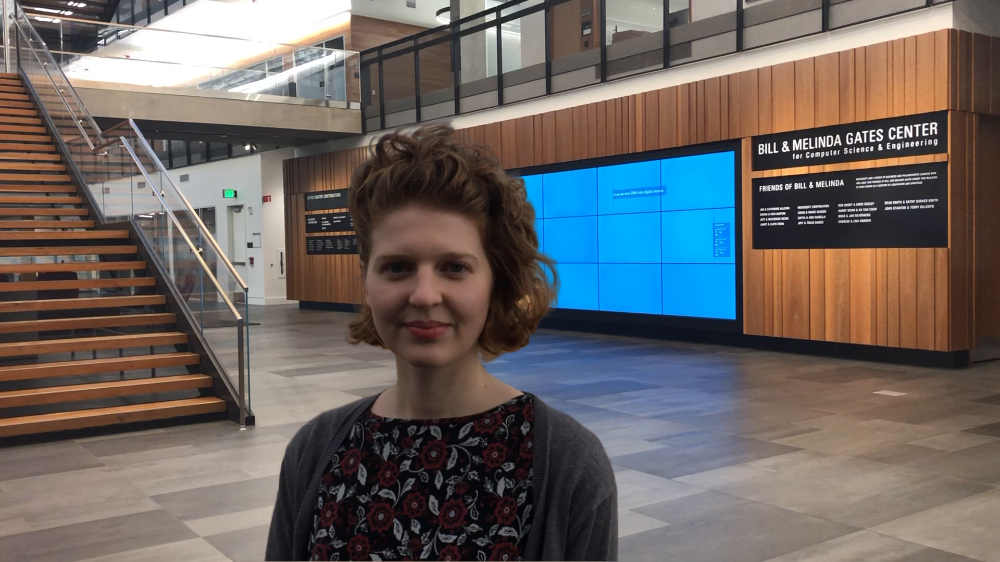

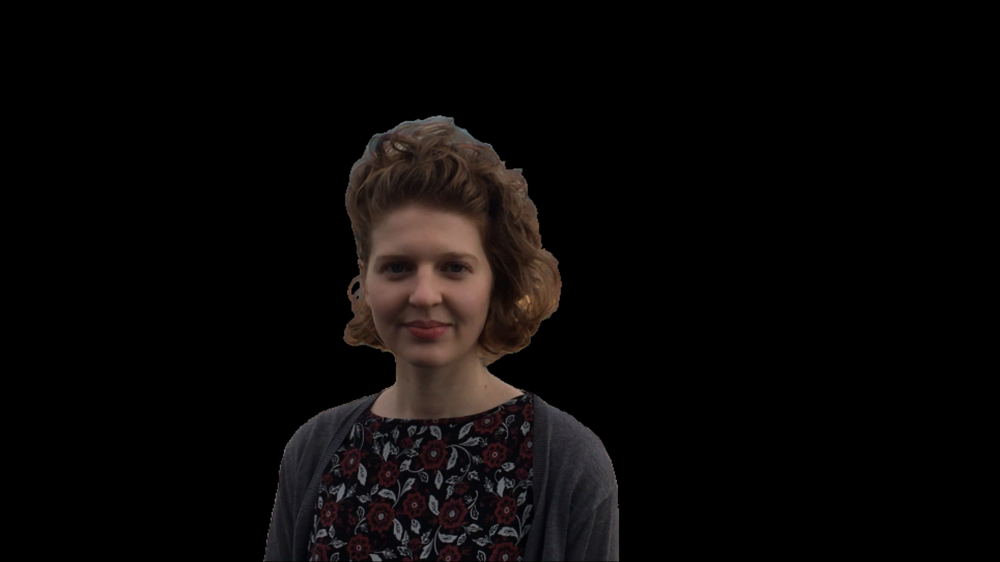

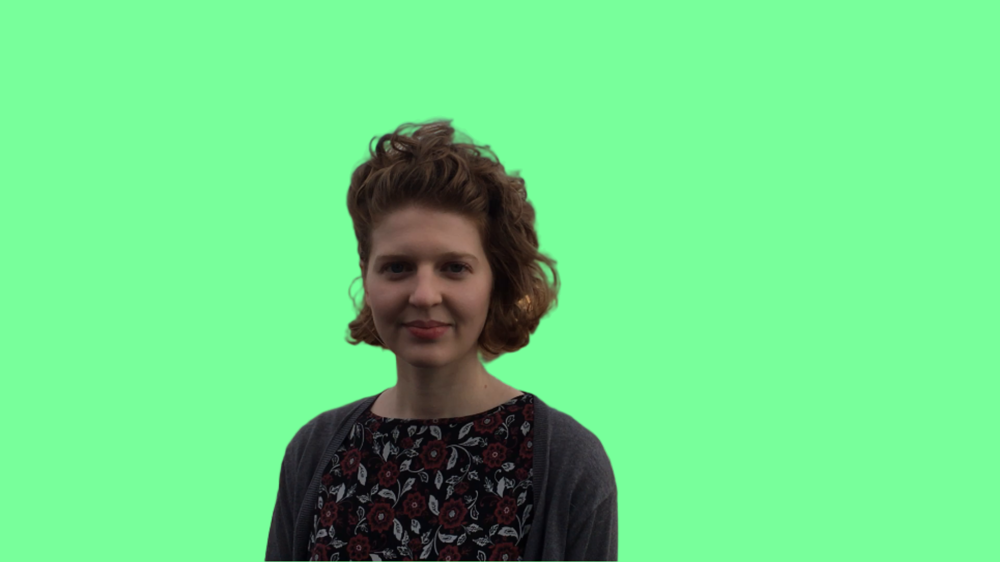

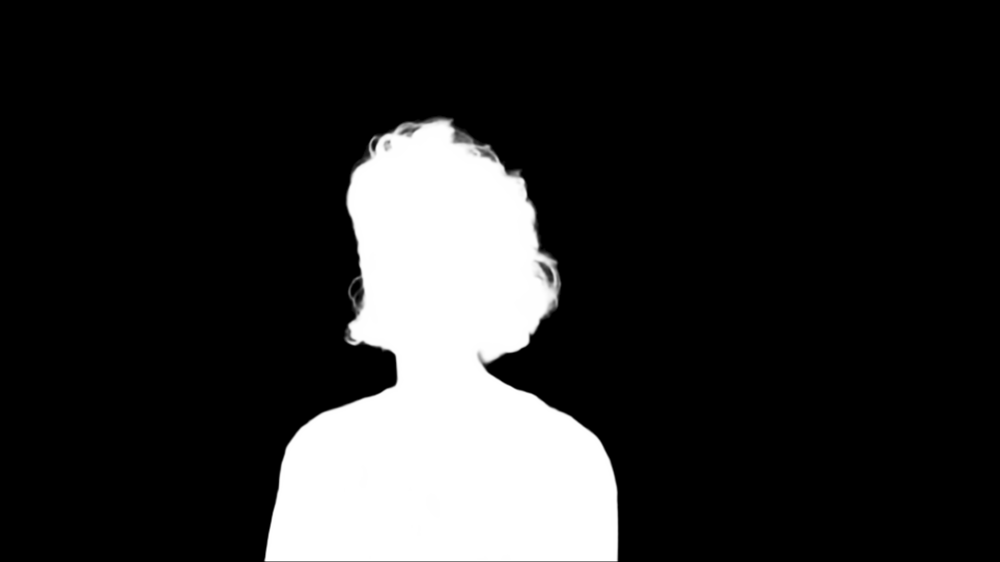

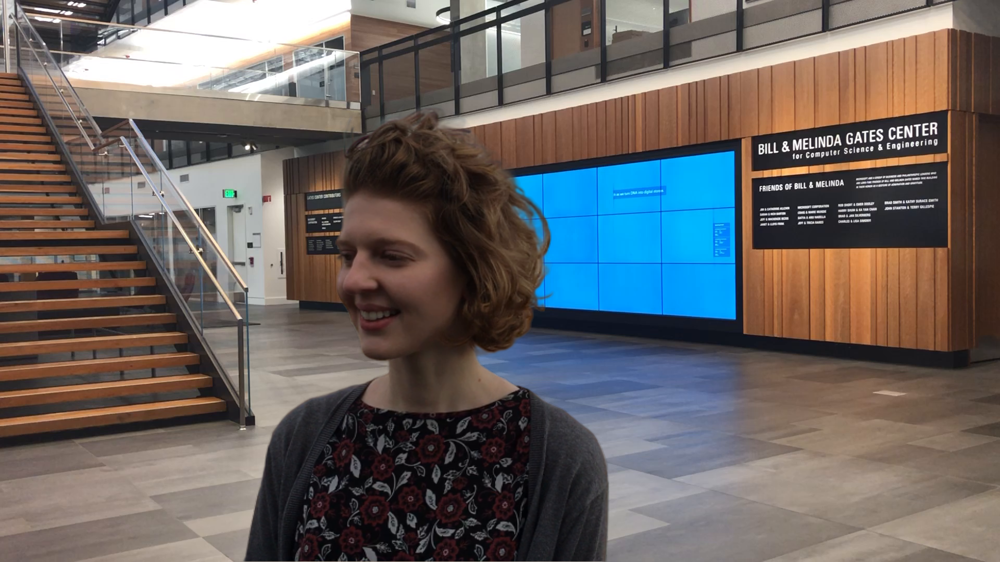

...

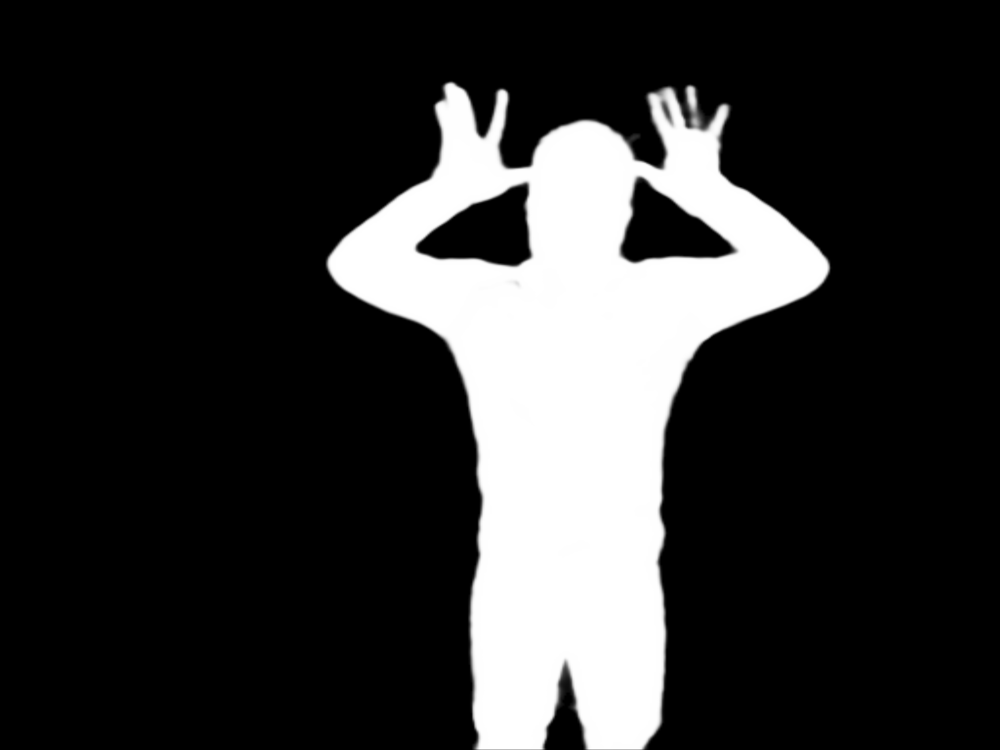

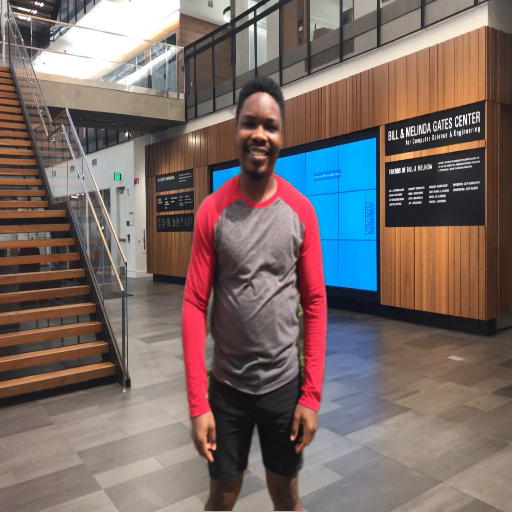

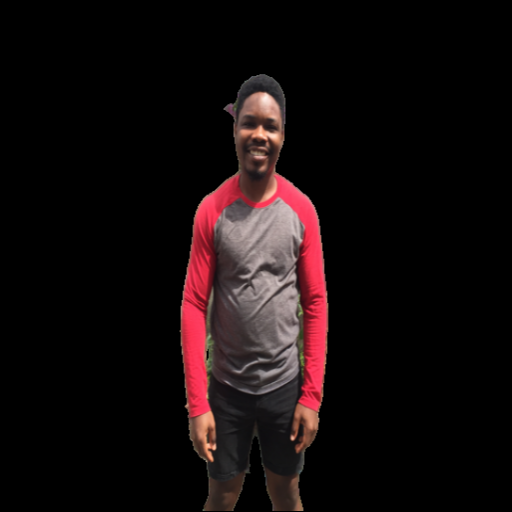

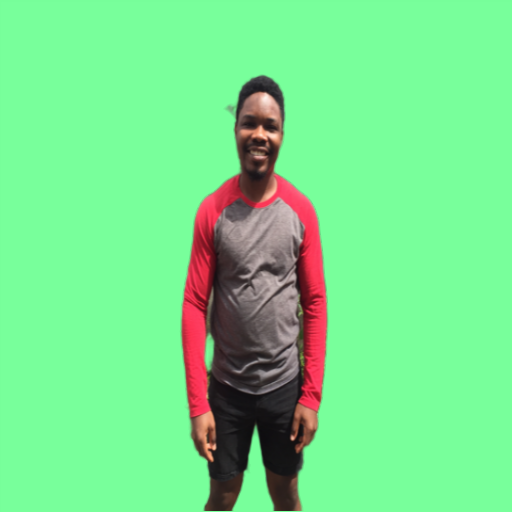

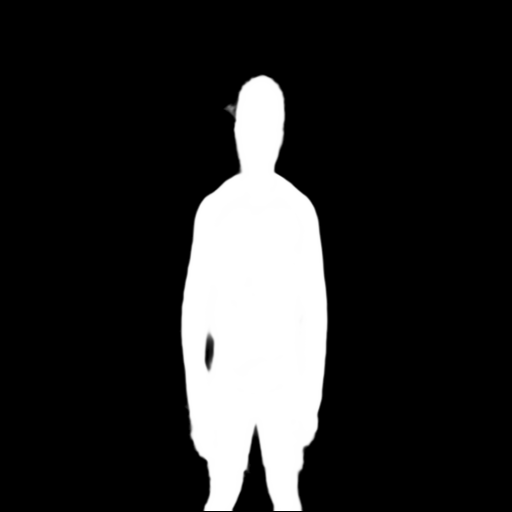

In [29]:
import cv2
from google.colab.patches import cv2_imshow
import glob
cv_img = []
for img in sorted(glob.glob('/content/Background-Matting/sample_data/output/background0/*.png')):
    n= cv2.imread(img)
    cv_img.append(n)
    cv2_imshow(n)

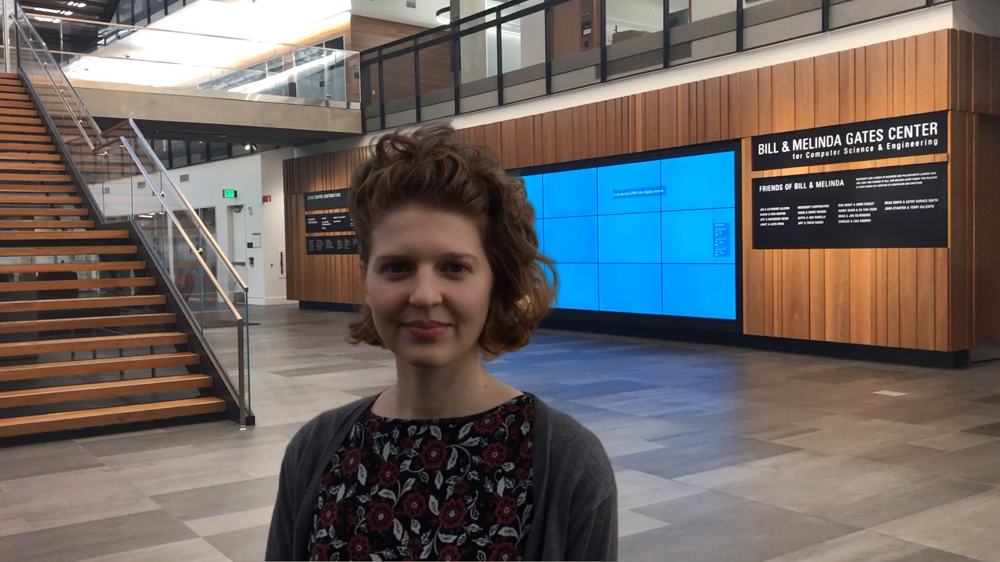

In [0]:
from google.colab.patches import cv2_imshow
cv2_imshow(cv_img[0])

In [0]:
from skimage.io import imread_collection

#your path 
col_dir = '/content/Background-Matting/sample_data/output/*.png'

#creating a collection with the available images
col = imread_collection(col_dir)

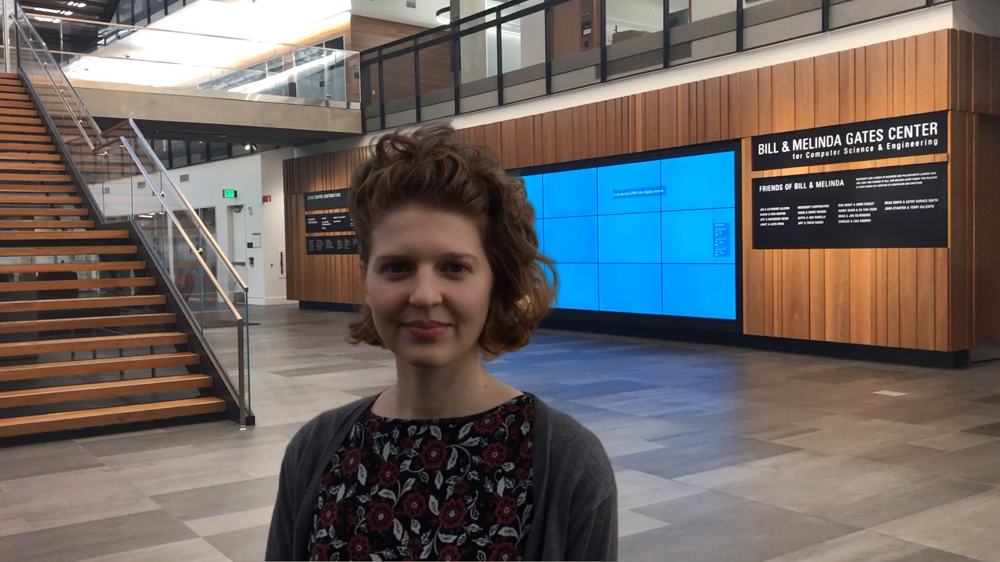

In [0]:
im_1 = cv2.cvtColor(col[0], cv2.COLOR_BGR2RGB)
cv2_imshow(im_1)

If you ever want to add pictures of you or your friends, you'll need to do the following:


1.   Provide 3 pictures:
i. One containing the subject(you or your friend). Save this image like this: my_image_img.png or my_friend_img.png. Dont forget the _img.png.
Place this image in sample_data/input

ii. Image of the background without the subject (use _back.png extension) eg: my_background_back.png.
Dont forget the _back.png extension. The script will look for this. Place it in sample_data/input as well.

iii. You need to provide a target background, where you want the subject to be placed. Place this in sample_data/background. You can name it anything you want. Just make sure the extension is .png
Alternatively, you could use one of the default backgrounds in the folder. But I challenge you to be creative.



Next, after you must have saved the images, don't forget to run the segmentation and preprocessing scripts again. The following is what you need to run:

In [0]:
!python test_segmentation_deeplab.py -i sample_data/input
!python test_pre_process.py -i sample_data/input
!python test_background-matting_image.py -m real-hand-held -i sample_data/input/ -o sample_data/output/ -tb sample_data/background/0001.png

Don't forget to change the target background to whatever you want.

That's it guys. You made it to the end. I hope you find this helpful. This is like a hobby to me, so if you are a fellow hobbyist and create some cool pictures off of this, please let me know in the comments or in the mail.


Most importantly, STAY SAFE, so you can read more of my geeky blog posts. :-)